In [2]:
import matplotlib.pyplot as plt 
%matplotlib inline

from dispersant_screener.utils import read_pickle, get_random_exploration_bl
import numpy as np 
from functools import partial
from matplotlib import animation, rc

In [32]:
history = read_pickle('../work/20200830-112437-history.pkl')

In [33]:
hvs = np.load('../work/20200830-112437-hypervolumes.npy')

In [34]:
y_train = np.load('../work/20200830-112437-y_train.npy')

In [35]:
y_test = np.load('../work/20200830-112437-y_test.npy')

In [36]:
X_test = np.load('../work/20200830-112437-X_test.npy')

In [37]:
y = np.vstack([y_train, y_test])

In [38]:
np.argmin(np.linalg.norm(X_test - np.mean(X_test, axis=0), axis=1))

1548

In [39]:
def get_summary_stats_time(history): 
    pareto = []
    non_pareto = []
    sampled = []
   
    pareto_indices = []
    non_pareto_indices = []
    sampled_indices = []
    
    for array in history['pareto']:
        pareto.append(sum(array))
        pareto_indices.append(np.where(array==1)[0])
        
    for array in history['non_pareto']:
        non_pareto.append(sum(array))
        non_pareto_indices.append(np.where(array==1)[0])
    
    for array in history['sampled']:
        sampled.append(sum(array))
        sampled_indices.append(np.where(array==1)[0])
        
    history_ = {}
        
    return pareto, non_pareto, sampled, pareto_indices, non_pareto_indices, sampled_indices

In [40]:
def animate_2d(i, ax, y, pareto_indices, non_pareto_indices, sampled_indices):
    ax.scatter(y[:,0], y[:,1], c='gray', s=1)
    ax.scatter(y[non_pareto_indices[i],0], y[non_pareto_indices[i],1], c='red', label='discarded', s=1)
    ax.scatter(y[sampled_indices[i],0], y[sampled_indices[i],1], c='blue', label='sampled', s=3)
    ax.scatter(y[pareto_indices[i],0], y[pareto_indices[i],1], c='green', label='Pareto', s=3)


In [41]:
pareto, non_pareto, sampled, pareto_indices, non_pareto_indices, sampled_indices = get_summary_stats_time(history)

In [42]:
unclassiefied = [len(history['pareto'][0])- pareto[i] - non_pareto[i] for i in range(len(pareto_indices))]

In [43]:
hv_random = get_random_exploration_bl(y)

In [44]:
np.where((reference_hv-hvs)/reference_hv * 100 < 5)

(array([ 40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,  52,
         53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,  65,
         66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,  78,
         79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,  91,
         92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103, 104,
        105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116, 117,
        118, 119, 120, 121, 122, 123, 124, 125]),)

In [45]:
np.where((reference_hv-np.array(hv_random))/reference_hv * 100 < 5)

(array([ 799,  800,  801, ..., 3122, 3123, 3124]),)

/Users/kevinmaikjablonka/opt/miniconda3/envs/dispersant_basf/lib/python3.7/site-packages/ipykernel_launcher.py:10: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  # Remove the CWD from sys.path while we load stuff.
/Users/kevinmaikjablonka/opt/miniconda3/envs/dispersant_basf/lib/python3.7/site-packages/ipykernel_launcher.py:11: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  # This is added back by InteractiveShellApp.init_path()
/Users/kevinmaikjablonka/opt/miniconda3/envs/dispersant_basf/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: 
The set_smart_bounds function was deprecated in Matplotlib 3.2 and will be removed two minor releases later.
  app.launch_new_instance()
/Users/kevinmaikjablonka/opt/miniconda3/envs/dispersant_basf/lib/python3.7/site-packages/ipyker

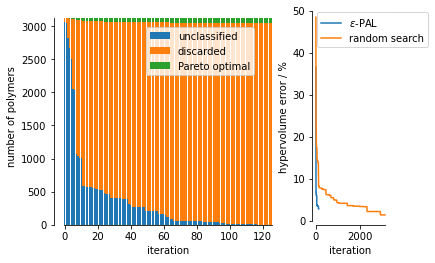

In [47]:
fig, ax = plt.subplots(1,2, gridspec_kw={'width_ratios': [3, 1]})
ax[0].bar(range(len(pareto)), unclassiefied, label='unclassified')
ax[0].bar(range(len(non_pareto)), non_pareto, bottom=unclassiefied, label='discarded')
ax[0].bar(range(len(pareto)), pareto, bottom=np.array(non_pareto)+ np.array(unclassiefied), label='Pareto optimal')
ax[0].set_xlabel('iteration')
ax[1].set_xlabel('iteration')
ax[0].set_ylabel('number of polymers')
ax[1].set_ylabel('hypervolume error / %')

ax[0].spines['left'].set_smart_bounds(True)
ax[0].spines['bottom'].set_smart_bounds(True)
ax[0].spines['right'].set_visible(False)
ax[0].spines['top'].set_visible(False)


ax[1].spines['left'].set_smart_bounds(True)
ax[1].spines['bottom'].set_smart_bounds(True)
ax[1].spines['right'].set_visible(False)
ax[1].spines['top'].set_visible(False)

ax[1].plot((reference_hv-hvs)/reference_hv * 100, label=r'$\epsilon$-PAL')
ax[1].plot((reference_hv-np.array(hv_random))/reference_hv * 100, label='random search')
ax[1].legend()

#fig.tight_layout()


ax[0].legend(loc='right', bbox_to_anchor=(0.9,0.8))


fig.savefig('barplot_draft_epsilon_005_all_coregionalized.pdf', bbox_inches='tight')

In [ ]:
artyjkl ;{{}}

In [81]:
ani = animation.FuncAnimation(fig, animate,frames=range(301)) 
plt.show()

In [82]:
from IPython.display import HTML

In [83]:
rc('animation', html='jshtml')
rc

HTML(ani.to_jshtml())

In [16]:
reference_hv = 1535

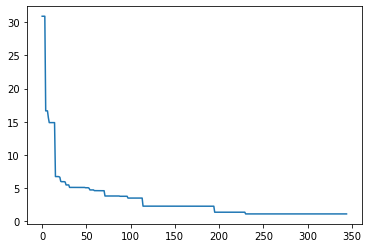

In [143]:
plt.plot((reference_hv-hvs)/reference_hv * 100)

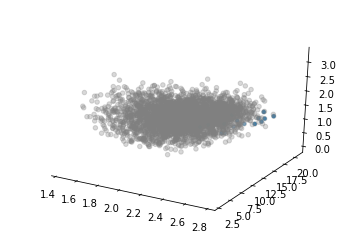

In [196]:
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

ax.scatter(y[:,0], y[:,1], y[:,2], alpha=.3, c='gray')
ax.scatter(y[pareto_indices[30],0], y[pareto_indices[30],1], y[pareto_indices[30],2], s=10)

ax.xaxis.pane.fill = False
ax.yaxis.pane.fill = False
ax.zaxis.pane.fill = False

ax.xaxis.pane.set_edgecolor('w')
ax.yaxis.pane.set_edgecolor('w')
ax.zaxis.pane.set_edgecolor('w')

ax.grid(False)

In [203]:
len(pareto)

264

In [239]:
def animate_3d(i, graph_discarded, graph_sampled, graph_pareto, y, pareto_indices, non_pareto_indices, sampled_indices):
    graph_discarded._offsets3d = (y[non_pareto_indices[i],0], y[non_pareto_indices[i],1], y[non_pareto_indices[i],2])
    graph_sampled._offsets3d = (y[sampled_indices[i],0], y[sampled_indices[i],1], y[sampled_indices[i],2])
    graph_pareto._offsets3d = (y[pareto_indices[i],0], y[pareto_indices[i],1], y[pareto_indices[i],2])


In [247]:
def get_3d_fig_ax(y, pareto_indices, non_pareto_indices, sampled_indices, xlabel=r'$R_g$', 
                  ylabel=r'$-\Delta G_\mathrm{ads}$', zlabel=r'$\Delta G_\mathrm{rep}$'):
    
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')
    graph = ax.scatter(y[:,0], y[:,1], y[:,2], c='gray', s=1)
    graph_discarded = ax.scatter(y[non_pareto_indices[0],0], y[non_pareto_indices[0],1], y[non_pareto_indices[0],2], c='red', label='discarded', s=1)
    graph_sampled = ax.scatter(y[sampled_indices[0],0], y[sampled_indices[0],1], y[sampled_indices[0],2], c='blue', label='sampled', s=3)
    graph_pareto = ax.scatter(y[pareto_indices[0],0], y[pareto_indices[0],1], y[pareto_indices[0],2], c='green', label='Pareto', s=10)
    
    ax.xaxis.pane.fill = False
    ax.yaxis.pane.fill = False
    ax.zaxis.pane.fill = False

    ax.xaxis.pane.set_edgecolor('w')
    ax.yaxis.pane.set_edgecolor('w')
    ax.zaxis.pane.set_edgecolor('w')

    ax.set_xlabel(xlabel)
    ax.set_ylabel(ylabel)
    ax.set_zlabel(zlabel)

    ax.grid(False)
    
    return graph_discarded, graph_sampled, graph_pareto, fig, ax

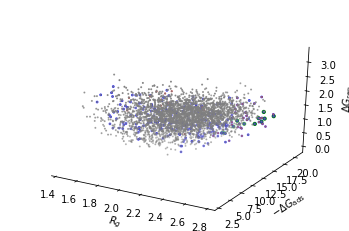

In [248]:
graph_discarded, graph_sampled, graph_pareto, fig, ax = get_3d_fig_ax(y, pareto_indices=pareto_indices, non_pareto_indices=non_pareto_indices, sampled_indices=sampled_indices)

In [249]:
animate = partial(animate_3d, graph_discarded=graph_discarded, graph_sampled=graph_sampled, graph_pareto=graph_pareto, y=y, pareto_indices=pareto_indices, non_pareto_indices=non_pareto_indices, sampled_indices=sampled_indices)

In [250]:
ani = animation.FuncAnimation(fig, animate,frames=range(264)) 

In [233]:
rc('animation', html='jshtml')
rc

HTML(ani.to_jshtml())

In [251]:
ani.save('animation.gif', writer='imagemagick', fps=40)